<a href="https://colab.research.google.com/github/eunhaday/AIFFEL_quest_cr/blob/master/AIFFELTHON_PRJ/textbook_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!rm -rf "/content/drive/MyDrive/Billiard"

## 멀티모달 모델 코드

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, LSTM, Concatenate
from tensorflow.keras.models import Model

# 1. 영상 데이터 처리 (YOLO 등으로 추출된 공의 위치와 경로)
video_input = Input(shape=(10, 256), name="video_input")  # 10개 프레임, 각 프레임 특징 256차원
print('video_input:',video_input)

video_features = LSTM(128, activation="relu")(video_input)

# 2. 교재 데이터 처리 (텍스트 임베딩)
text_input = Input(shape=(512,), name="text_input")  # 512차원 텍스트 벡터
text_features = Dense(128, activation="relu")(text_input)

# 3. 데이터 결합
combined = Concatenate()([video_features, text_features])
combined_output = Dense(64, activation="relu")(combined)
final_output = Dense(1, activation="sigmoid")(combined_output)  # 예: 성공/실패 예측

# 모델 정의
model = Model(inputs=[video_input, text_input], outputs=final_output)

# 컴파일 및 요약
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy"])
model.summary()


video_input: <KerasTensor shape=(None, 10, 256), dtype=float32, sparse=False, name=video_input>


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ video_input (InputLayer)  │ (None, 10, 256)        │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ text_input (InputLayer)   │ (None, 512)            │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_2 (LSTM)             │ (None, 128)            │        197,120 │ video_input[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_6 (Dense)           │ (None, 128)            │         65,664 │ text_input[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_2             │ (None, 256)            │              0 │ lstm_2[0][0],          │
│ (Concatenate)             │                        │                │ dense_6[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_7 (Dense)           │ (None, 64)             │         16,448 │ concatenate_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_8 (Dense)           │ (None, 1)              │             65 │ dense_7[0][0]          │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 279,297 (1.07 MB)

 Trainable params: 279,297 (1.07 MB)

 Non-trainable params: 0 (0.00 B)

### 교재 데이터 처리
#### 텍스트 데이터를 임베딩 벡터로 변환

In [ ]:
from transformers import BertTokenizer, TFBertModel

# BERT 모델 준비
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
bert_model = TFBertModel.from_pretrained("bert-base-uncased")

# 텍스트 데이터 임베딩
texts = ["This is a shot strategy example.", "Use top spin for better control."]
text_features = bert_model(tokenizer(texts, return_tensors="tf", padding=True, truncation=True))["pooler_output"]


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.bias', 'cls.seq_relationship.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions w

In [ ]:
# pip를 사용하여 Ultralytics 설치
!pip install ultralytics
!pip install pybullet


0: 384x640 1 tv, 398.6ms
Speed: 5.1ms preprocess, 398.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Data saved to /content/drive/MyDrive/detect_objects.csv


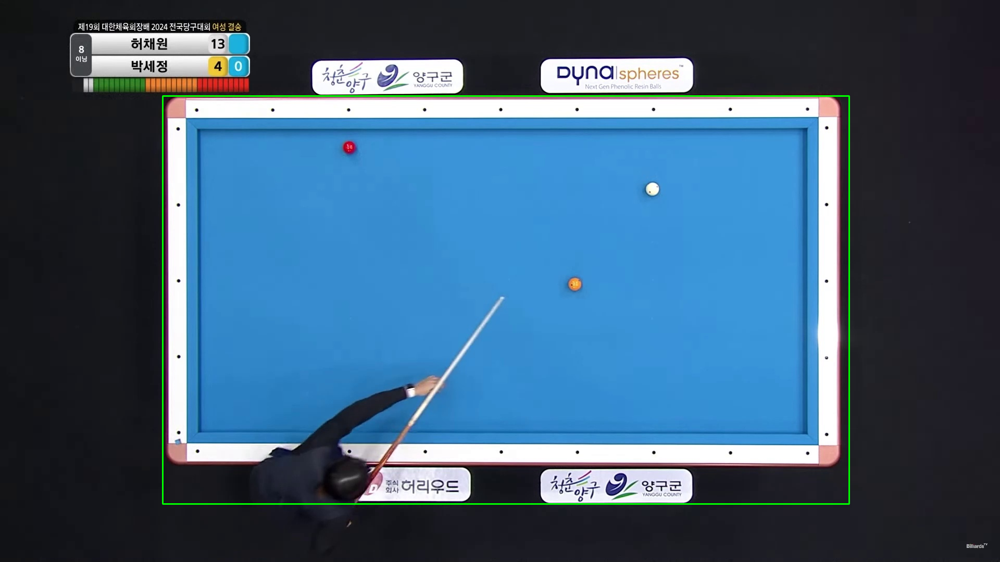

In [ ]:
import cv2
import numpy as np
import torch
from ultralytics import YOLO  # Use YOLOv8 for ball and pocket detection
import pybullet as p
import pybullet_data
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab
import pandas as pd
import os

# Load the pre-trained YOLO model
#model = YOLO("yolov8n.pt")

# Step 1: Load and Preprocess Image
def preprocess_image(image_path):
    image = cv2.imread(image_path)
    #cv2_imshow(image)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray, 50, 150)
    #cv2_imshow(gray)
    #cv2_imshow(edges)
    return image, edges

# Step 2: Ball and Pocket Detection using YOLO
def detect_objects(model_path, image):
    model = YOLO(model_path)  # Load pre-trained YOLO model
    results = model(image)
    objects = []

    for box in results[0].boxes:  # Corrected YOLO result access
        x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
        conf = box.conf[0].cpu().numpy()
        cls = box.cls[0].cpu().numpy()
        center_x = (x1 + x2) / 2
        center_y = (y1 + y2) / 2
        objects.append({
            "center": (center_x, center_y),
            "bbox": (x1, y1, x2, y2),
            "confidence": conf,
            "class": cls
        })

    # Save to CSV
    output_file = "/content/drive/MyDrive/detect_objects.csv"
    pd.DataFrame(objects).to_csv(output_file, index=False)
    print(f"Data saved to {output_file}")

    return objects

""" # Step 3: Physics Simulation for Path Prediction
def setup_physics():
    p.connect(p.DIRECT)
    p.setAdditionalSearchPath(pybullet_data.getDataPath())

    #print('pybullet_data:',pybullet_data.getDataPath())

    p.setGravity(0, 0, -9.8)
    table_id = p.loadURDF("/content/drive/MyDrive/table.urdf")
    return table_id
"""

# Step 3: Physics Simulation for Path Prediction
def setup_physics():
    p.connect(p.DIRECT)
    p.setAdditionalSearchPath(pybullet_data.getDataPath())

    # Load the billiard table URDF
    table_urdf_path = "/content/drive/MyDrive/table.urdf"
    if not os.path.exists(table_urdf_path):
        raise FileNotFoundError(f"URDF file not found: {table_urdf_path}")

    table_id = p.loadURDF(table_urdf_path)
    print(f"Loaded URDF: {table_urdf_path}")
    return table_id

def simulate_shot(ball_position, target_position, force):
    ball_id = p.loadURDF("/content/drive/MyDrive/sphere2.urdf", ball_position)
    p.applyExternalForce(ball_id, -1, force, [0, 0, 0], p.WORLD_FRAME)
    for _ in range(240):  # Simulate for 4 seconds at 60Hz
        p.stepSimulation()
    final_position = p.getBasePositionAndOrientation(ball_id)[0]
    return final_position

# Step 4: Visualization
def visualize_results(image, objects, paths):
    for obj in objects:
        x1, y1, x2, y2 = map(int, obj["bbox"])
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
    for path in paths:
        cv2.line(image, path[0], path[1], (255, 0, 0), 2)
    #cv2.imshow("Results", image)

    cv2_imshow(image)
    cv2.waitKey(0)

# Main Function
def main(image_path, model_path):
    image, edges = preprocess_image(image_path)
    objects = detect_objects(model_path, image)
    #table_id = setup_physics()

    # Example: Predict paths for the first two balls
    paths = []
    if len(objects) >= 2:
        ball_position = [objects[0]["bbox"][:2], 0]  # Use 2D position, add Z=0
        target_position = [objects[1]["bbox"][:2], 0]
        force = [10, 10, 0]  # Example force vector
        final_position = simulate_shot(ball_position, target_position, force)
        paths.append((tuple(ball_position[:2]), tuple(final_position[:2])))

    visualize_results(image, objects, paths)

if __name__ == "__main__":
    #main("billiards_table.jpg", "yolov8_model.pt")
    main("/content/drive/MyDrive/Billiard/Input_mp4/frames/single_frame.jpg", "yolo11n.pt")


In [ ]:
#-----------------------------------------------------------
# 동영상에서 이미지 파일로 캡쳐해서 폴더아래 저장하는 기능
#-----------------------------------------------------------

import cv2
import os

def extract_shot_frames(video_path, output_dir, frame_interval=5):
    cap = cv2.VideoCapture(video_path)
    os.makedirs(output_dir, exist_ok=True)
    frame_count = 0
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        # 프레임 간격 설정
        if int(cap.get(cv2.CAP_PROP_POS_FRAMES)) % frame_interval == 0:
            cv2.imwrite(os.path.join(output_dir, f"frame_{frame_count}.jpg"), frame)
            frame_count += 1

    cap.release()
    print(f"Extracted {frame_count} frames.")

extract_shot_frames("/content/drive/MyDrive/billiard_game.mp4", "/content/drive/MyDrive/Billiard/Input_mp4/frames", frame_interval=10)

In [ ]:
#-----------------------------------------------
# 동영상에서 이미지 파일로 하나만 잘라서 저장
#-----------------------------------------------

import cv2
import os

def extract_single_frame(video_path, output_dir):
    cap = cv2.VideoCapture(video_path)
    os.makedirs(output_dir, exist_ok=True)

    ret, frame = cap.read()
    print('ret:',ret)

    if ret:
        # Save only the first frame
        cv2.imwrite(os.path.join(output_dir, "single_frame.jpg"), frame)
        print("Frame saved successfully.")
    else:
        print("Failed to read the video.")

    cap.release()

extract_single_frame("/content/drive/MyDrive/billiard_game.mp4", "/content/drive/MyDrive/Billiard/Input_mp4/frames")


ret: True
Frame saved successfully.


In [ ]:

# Load the pre-trained YOLO model
#model = YOLO("yolov8n.pt")
model = YOLO("yolo11n.pt")

100%|██████████| 5.35M/5.35M [00:00<00:00, 63.3MB/s]


In [ ]:
from ultralytics import YOLO

# Load a pretrained YOLO11n model
model = YOLO("yolo11n.pt")

# Run inference on an image
results = model("/content/drive/MyDrive/Billiard/Input_mp4/frames/frame_0.jpg")  # results list

# View results
for r in results:
    print(r.boxes)  # print the Boxes object containing the detection bounding boxes


image 1/1 /content/drive/MyDrive/Billiard/Input_mp4/frames/frame_0.jpg: 384x640 1 person, 1 tv, 377.1ms
Speed: 7.6ms preprocess, 377.1ms inference, 7.7ms postprocess per image at shape (1, 3, 384, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([62.,  0.])
conf: tensor([0.6972, 0.5363])
data: tensor([[3.0342e+02, 1.8651e+02, 1.6252e+03, 9.3498e+02, 6.9721e-01, 6.2000e+01],
        [3.0057e+02, 7.0011e+02, 8.7273e+02, 1.0661e+03, 5.3630e-01, 0.0000e+00]])
id: None
is_track: False
orig_shape: (1080, 1920)
shape: torch.Size([2, 6])
xywh: tensor([[ 964.2994,  560.7407, 1321.7594,  748.4696],
        [ 586.6498,  883.1010,  572.1581,  365.9736]])
xywhn: tensor([[0.5022, 0.5192, 0.6884, 0.6930],
        [0.3055, 0.8177, 0.2980, 0.3389]])
xyxy: tensor([[ 303.4197,  186.5059, 1625.1791,  934.9755],
        [ 300.5708,  700.1142,  872.7289, 1066.0878]])
xyxyn: tensor([[0.1580, 0.1727, 0.8464, 0.8657],
        [0.1565, 0.6483, 0.4545, 0.9871]])



image 1/1 /content/drive/MyDrive/Billiard/Input_mp4/frames/single_frame.jpg: 384x640 1 person, 1 laptop, 680.4ms
Speed: 5.6ms preprocess, 680.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
plots: [[[18 19 17]
  [18 19 17]
  [19 20 18]
  ...
  [31 22 25]
  [31 22 25]
  [31 22 25]]

 [[19 20 18]
  [19 20 18]
  [19 20 18]
  ...
  [31 22 25]
  [31 22 25]
  [31 22 25]]

 [[19 20 18]
  [19 20 18]
  [19 20 18]
  ...
  [31 22 25]
  [31 22 25]
  [31 22 25]]

 ...

 [[21 19 19]
  [21 19 19]
  [21 19 19]
  ...
  [31 26 25]
  [34 29 28]
  [36 31 30]]

 [[21 19 19]
  [21 19 19]
  [21 19 19]
  ...
  [30 26 25]
  [37 33 32]
  [40 36 35]]

 [[21 19 19]
  [21 19 19]
  [21 19 19]
  ...
  [30 26 25]
  [40 36 35]
  [43 39 38]]]


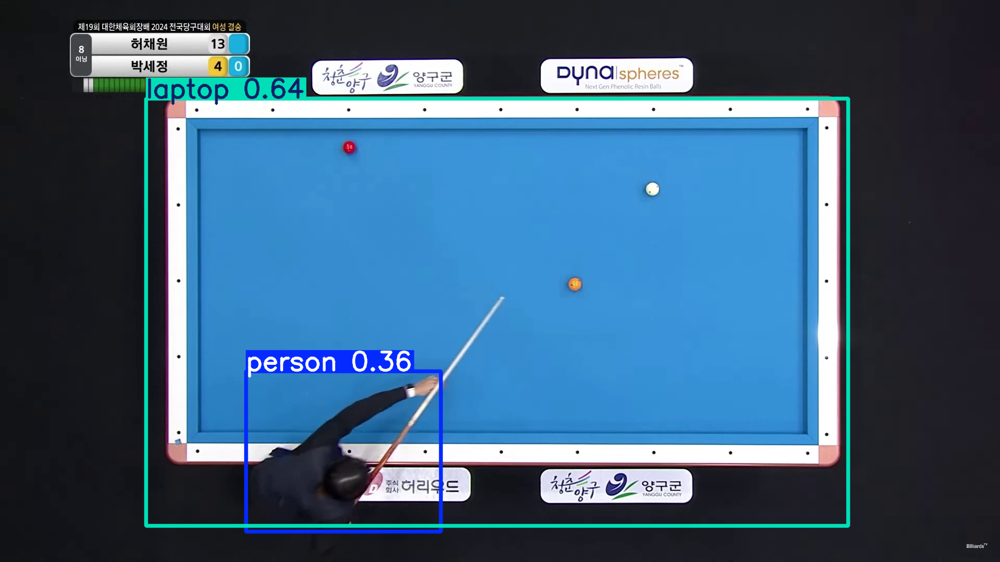

In [ ]:
from ultralytics import YOLO
import cv2
model = YOLO("yolov8s.pt")
results = model("/content/drive/MyDrive/Billiard/Input_mp4/frames/single_frame.jpg")
plots = results[0].plot()
print('plots:',plots)

cv2_imshow(plots)
cv2.waitKey(0)
cv2.destroyAllWindows()




image 1/1 /content/drive/MyDrive/Billiard/Input_mp4/frames/single_frame.jpg: 384x640 1 person, 1 laptop, 367.3ms
Speed: 2.8ms preprocess, 367.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


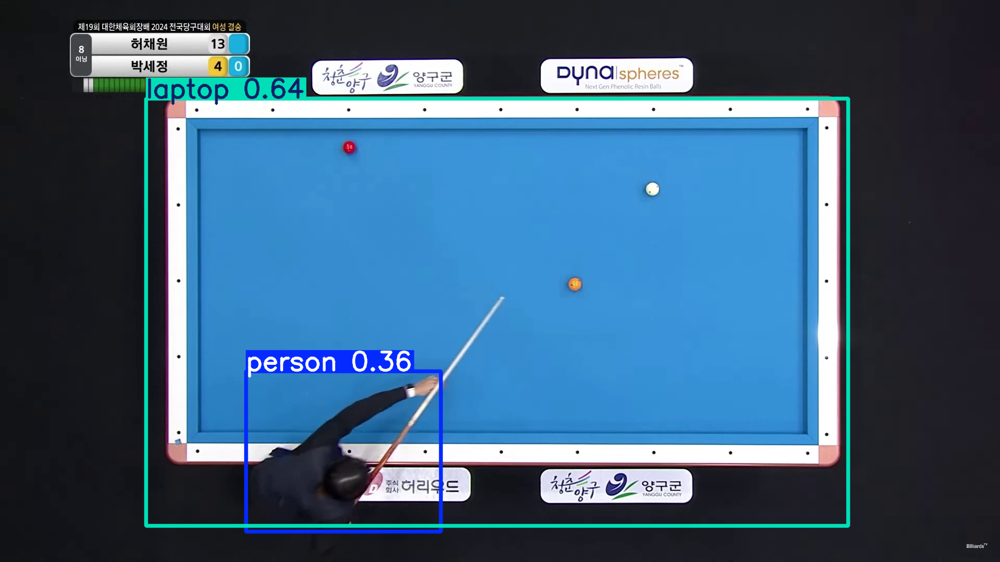

box.xyxy:  [[280.9336242675781, 189.621826171875, 1628.0291748046875, 1010.0960083007812]]
-----------
box.conf:  [0.6383671760559082]
-----------
box.cls:  [63.0]
-----------
box.xyxy:  [[472.3911437988281, 713.4795532226562, 846.422607421875, 1021.7735595703125]]
-----------
box.conf:  [0.35773205757141113]
-----------
box.cls:  [0.0]
-----------


In [ ]:
from ultralytics import YOLO
import cv2
model = YOLO("yolov8s.pt")

results = model("/content/drive/MyDrive/Billiard/Input_mp4/frames/single_frame.jpg")
plots = results[0].plot()

cv2_imshow(plots)
cv2.waitKey(0)
cv2.destroyAllWindows()

boxes = results[0].boxes

for box in boxes :
    print('box.xyxy: ', box.xyxy.cpu().detach().numpy().tolist())
    print("-----------")
    print('box.conf: ', box.conf.cpu().detach().numpy().tolist())
    print("-----------")
    print('box.cls: ', box.cls.cpu().detach().numpy().tolist())
    print("-----------")



100%|██████████| 21.5M/21.5M [00:00<00:00, 77.7MB/s]



0: 384x640 1 person, 1 laptop, 830.3ms
Speed: 4.5ms preprocess, 830.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


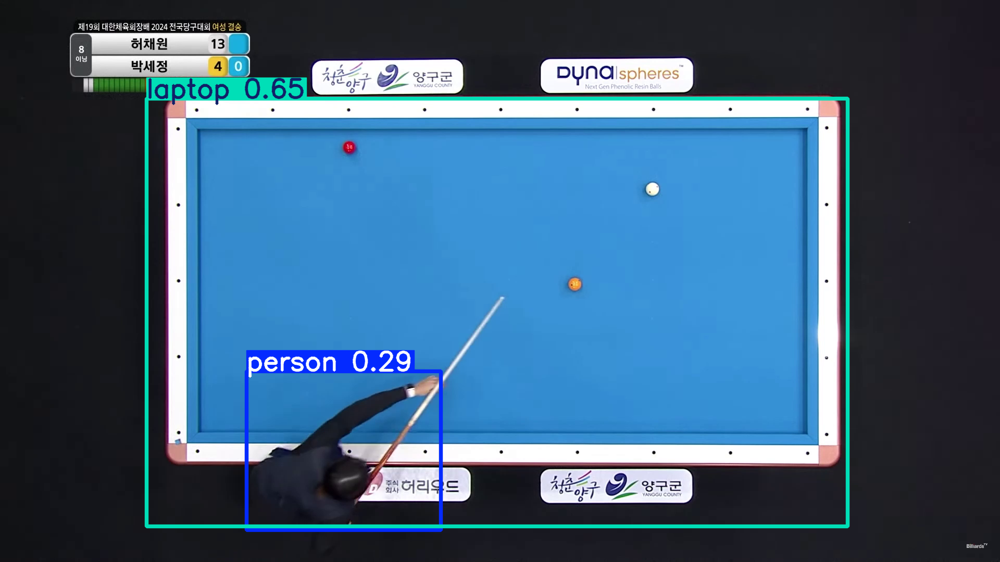


0: 384x640 1 person, 1 laptop, 825.5ms
Speed: 8.0ms preprocess, 825.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


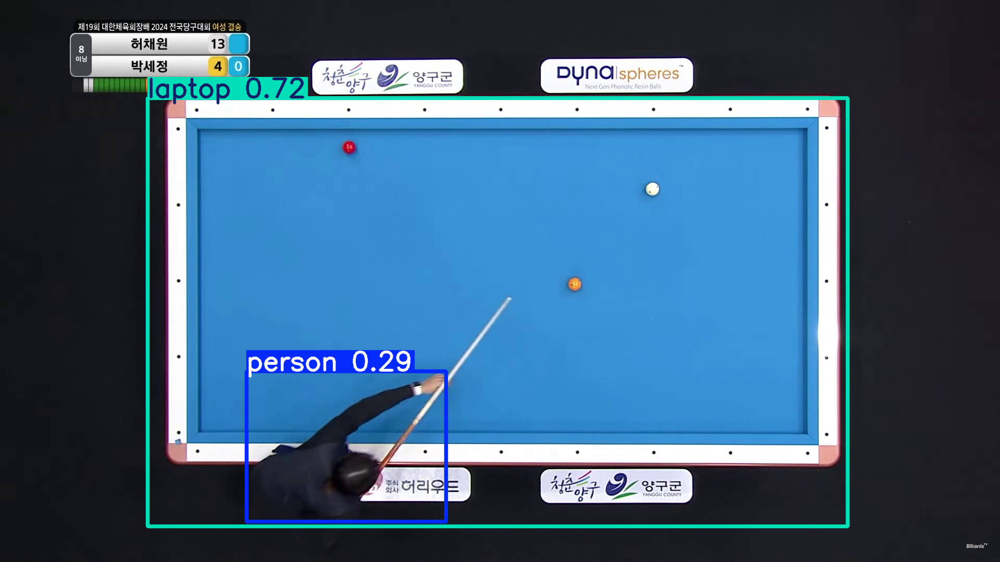


0: 384x640 1 laptop, 682.2ms
Speed: 4.2ms preprocess, 682.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


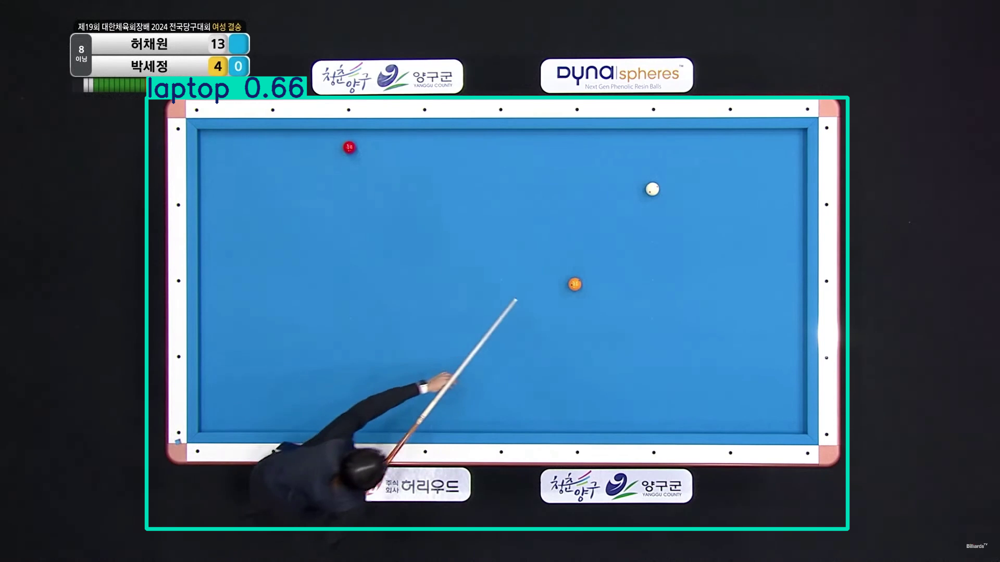


0: 384x640 1 laptop, 663.6ms
Speed: 4.2ms preprocess, 663.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


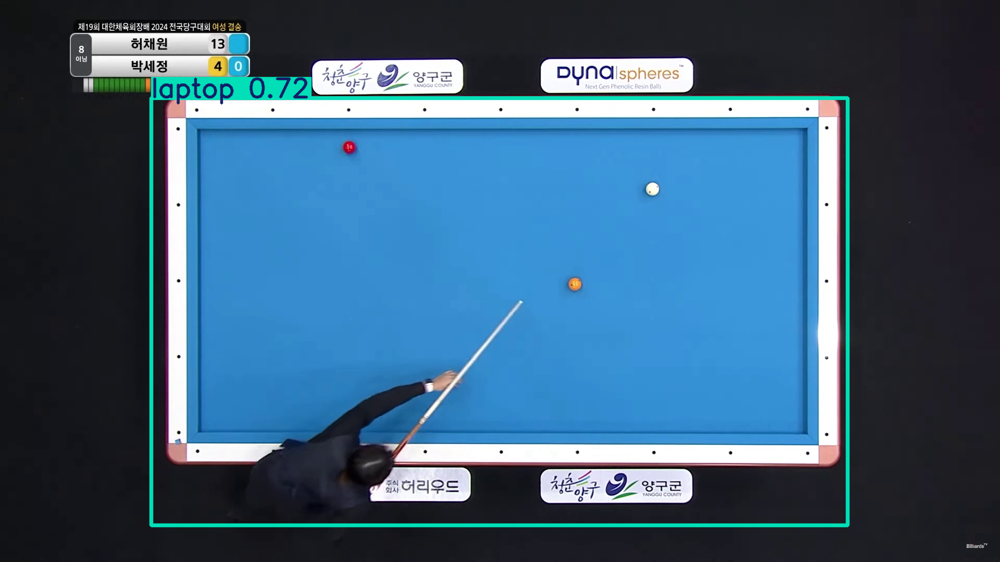


0: 384x640 1 person, 1 laptop, 644.7ms
Speed: 6.2ms preprocess, 644.7ms inference, 4.5ms postprocess per image at shape (1, 3, 384, 640)


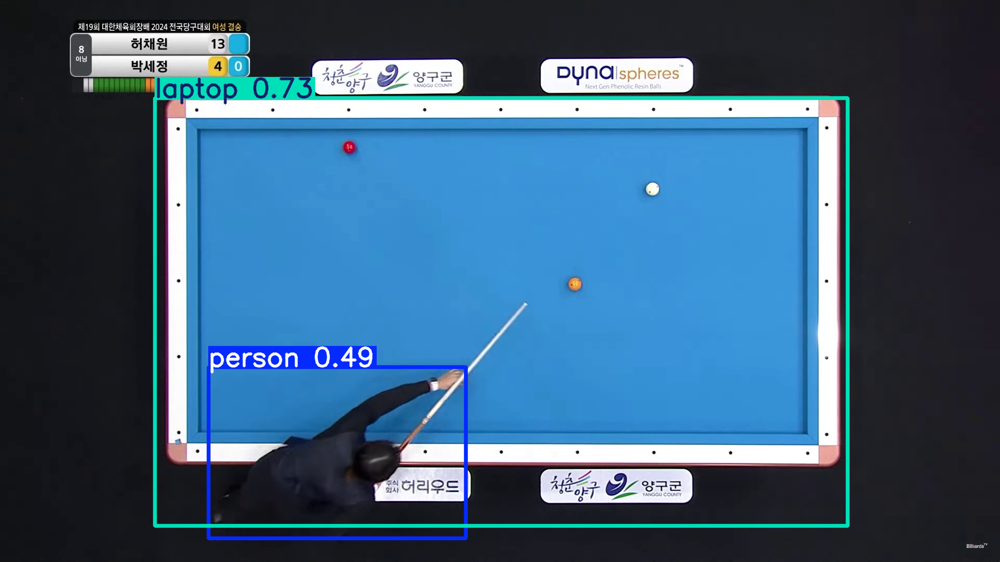


0: 384x640 1 person, 1 laptop, 760.2ms
Speed: 3.5ms preprocess, 760.2ms inference, 5.6ms postprocess per image at shape (1, 3, 384, 640)


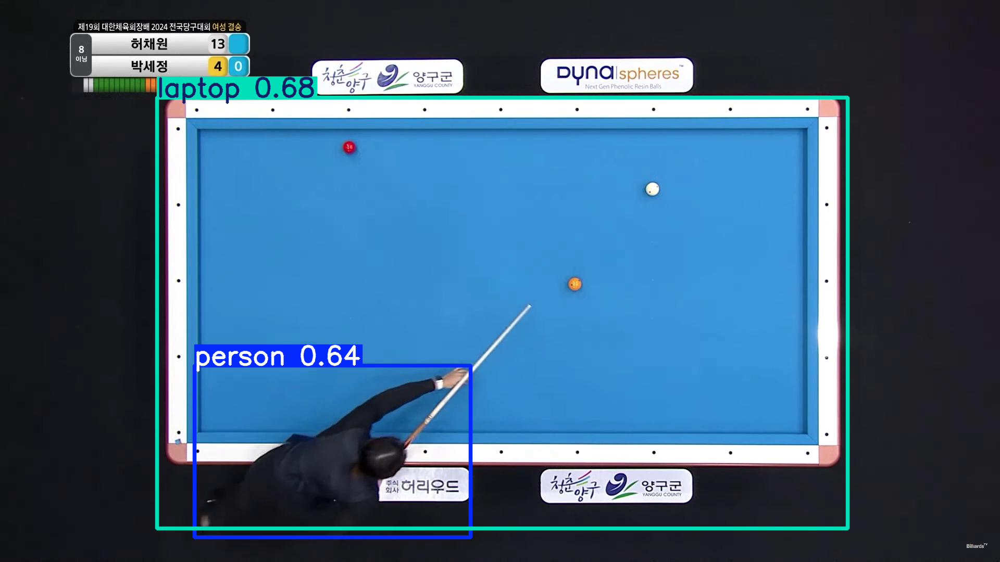


0: 384x640 1 person, 1 tv, 1 laptop, 641.1ms
Speed: 4.7ms preprocess, 641.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


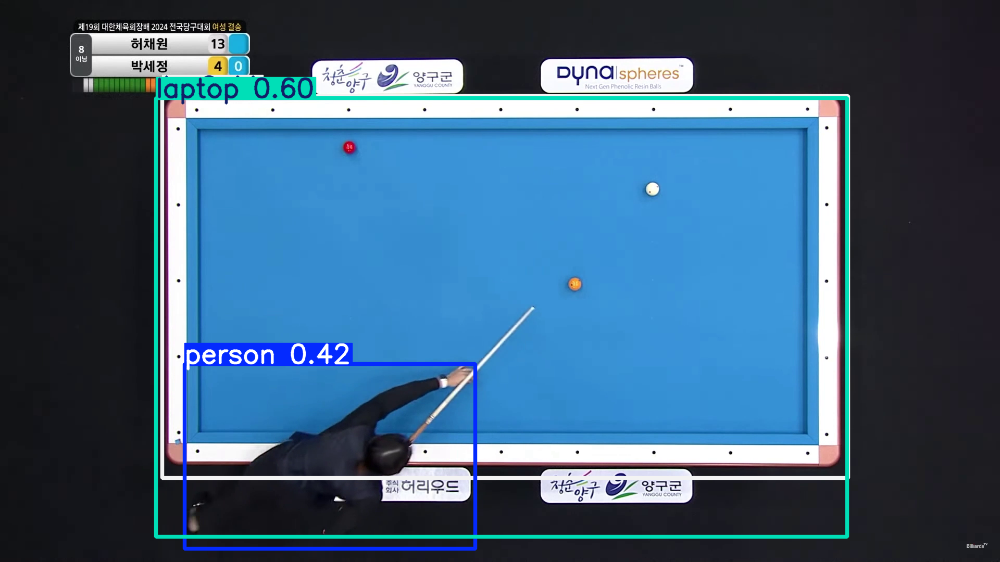


0: 384x640 1 laptop, 699.5ms
Speed: 9.0ms preprocess, 699.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


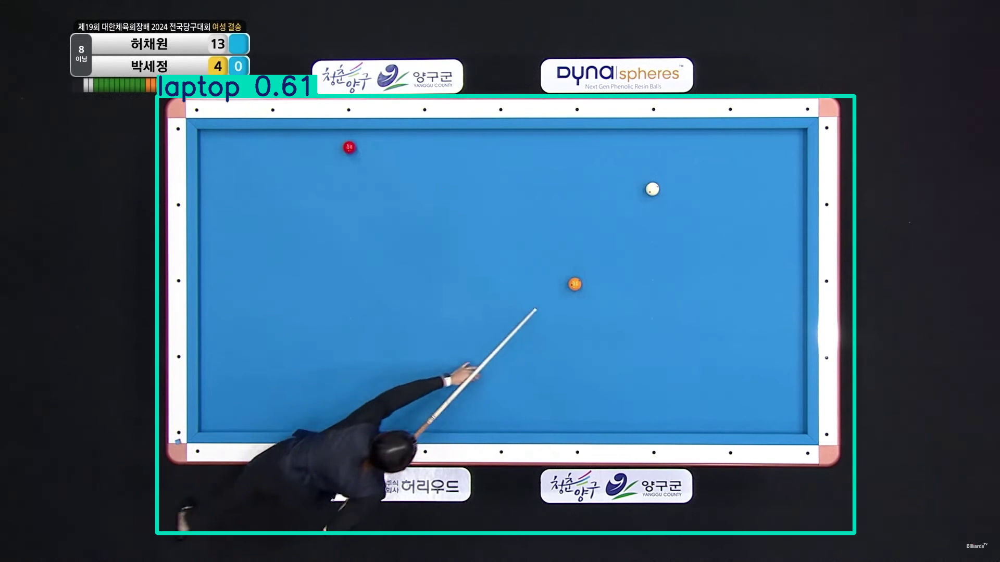


0: 384x640 1 person, 1 laptop, 589.0ms
Speed: 4.0ms preprocess, 589.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


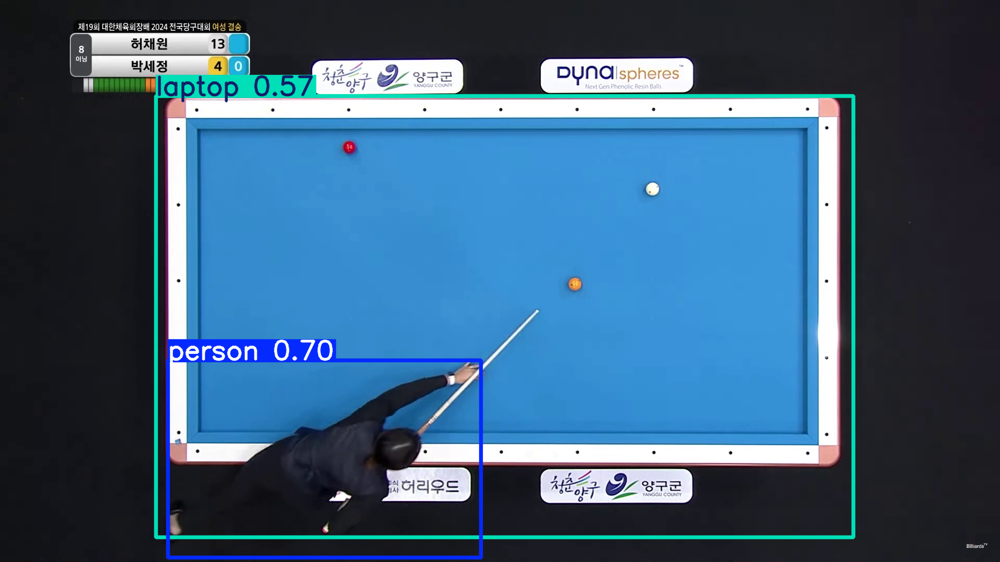


0: 384x640 1 person, 1 sports ball, 1 laptop, 612.0ms
Speed: 4.2ms preprocess, 612.0ms inference, 4.0ms postprocess per image at shape (1, 3, 384, 640)


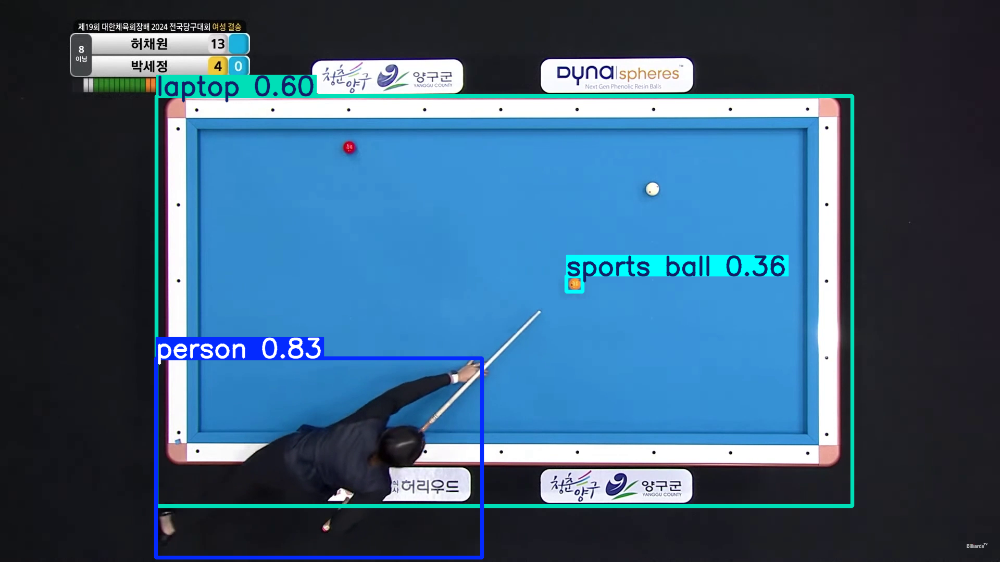


0: 384x640 1 person, 1 sports ball, 1 laptop, 675.8ms
Speed: 3.9ms preprocess, 675.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


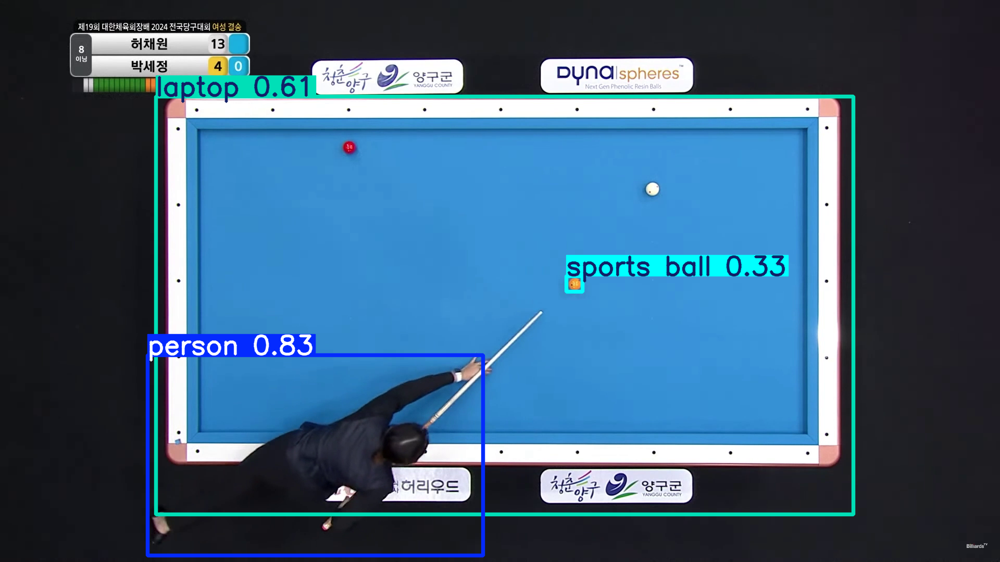


0: 384x640 1 person, 1 sports ball, 1 laptop, 1 scissors, 627.0ms
Speed: 6.9ms preprocess, 627.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


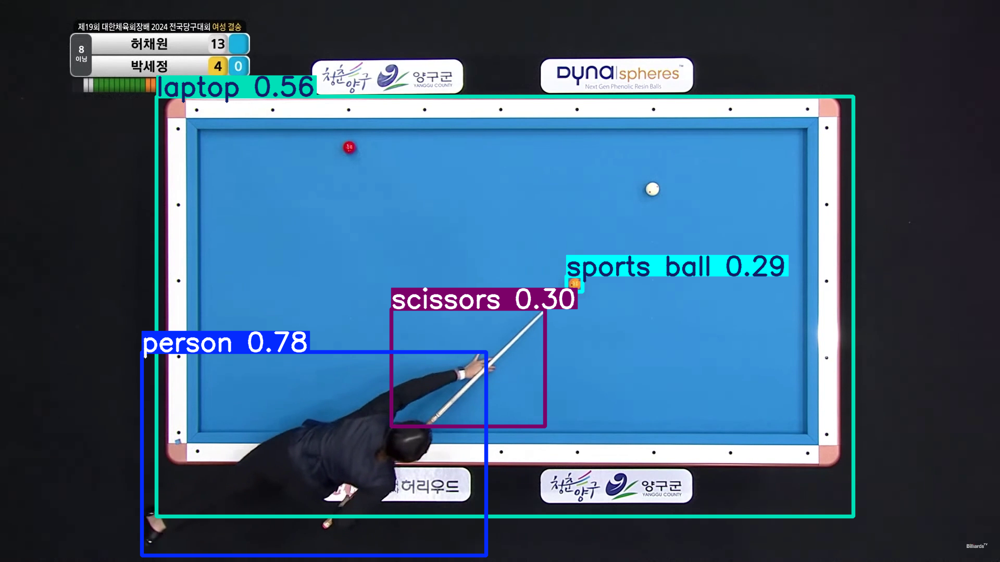


0: 384x640 1 person, 1 sports ball, 1 laptop, 1 scissors, 643.5ms
Speed: 4.5ms preprocess, 643.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


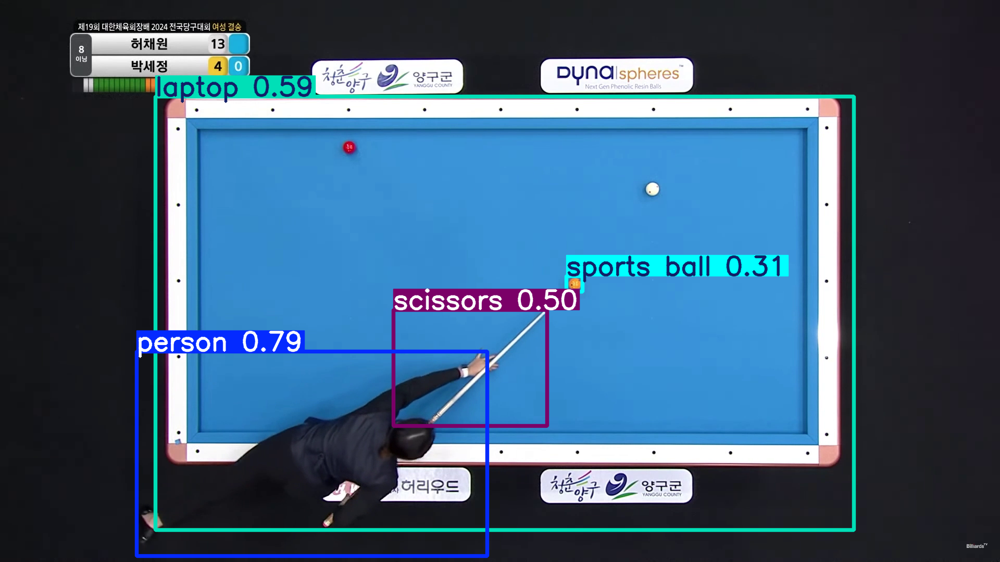


0: 384x640 1 person, 1 sports ball, 1 laptop, 1 scissors, 619.9ms
Speed: 11.2ms preprocess, 619.9ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


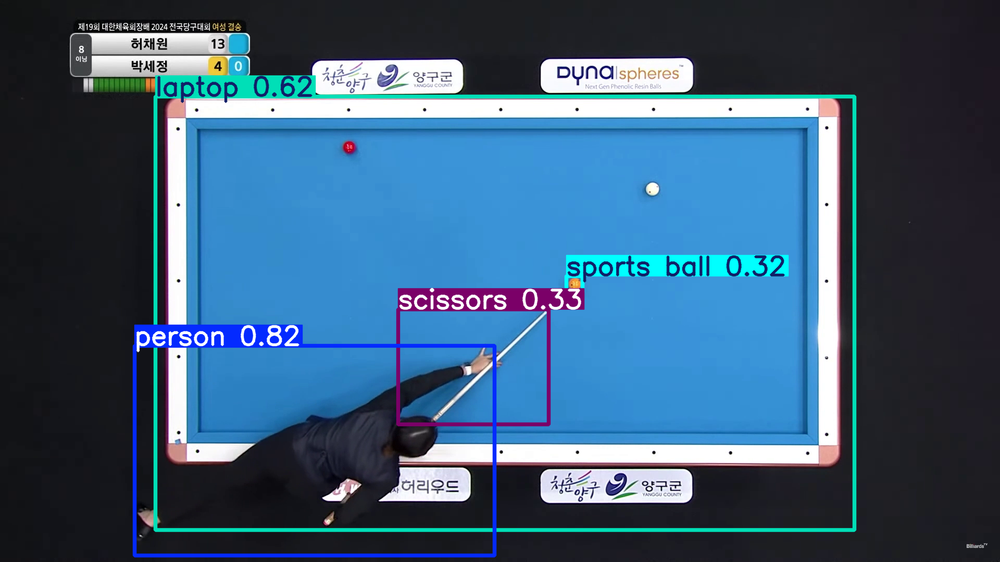


0: 384x640 1 person, 1 sports ball, 1 laptop, 1 scissors, 605.3ms
Speed: 4.2ms preprocess, 605.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


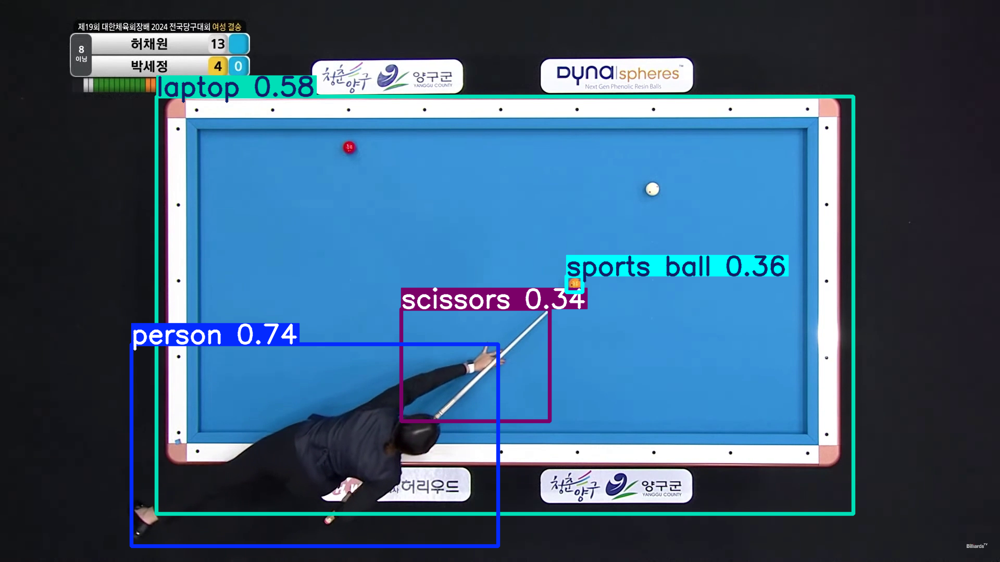


0: 384x640 1 person, 1 sports ball, 1 laptop, 1 scissors, 583.7ms
Speed: 10.3ms preprocess, 583.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


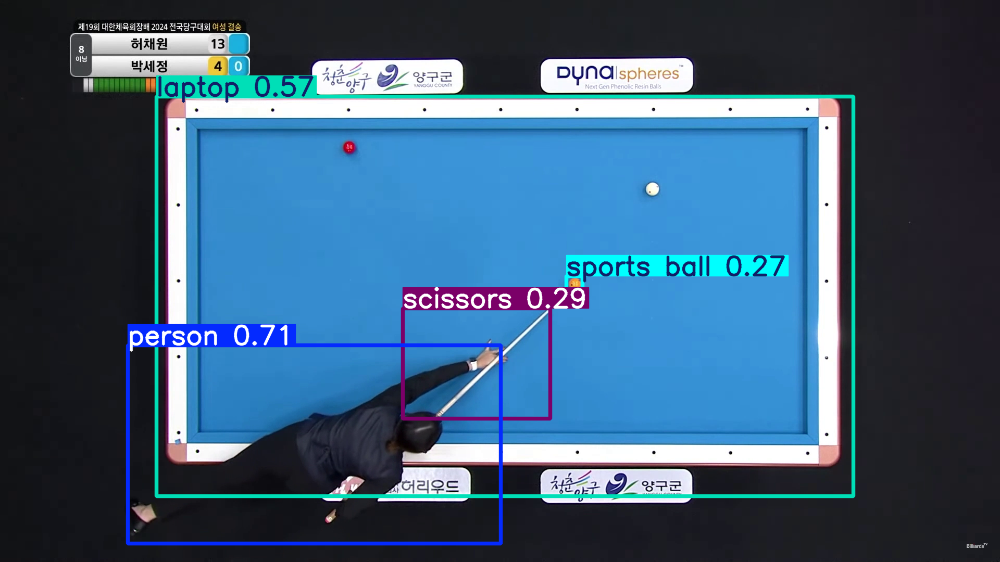


0: 384x640 1 person, 1 sports ball, 1 laptop, 574.7ms
Speed: 4.1ms preprocess, 574.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


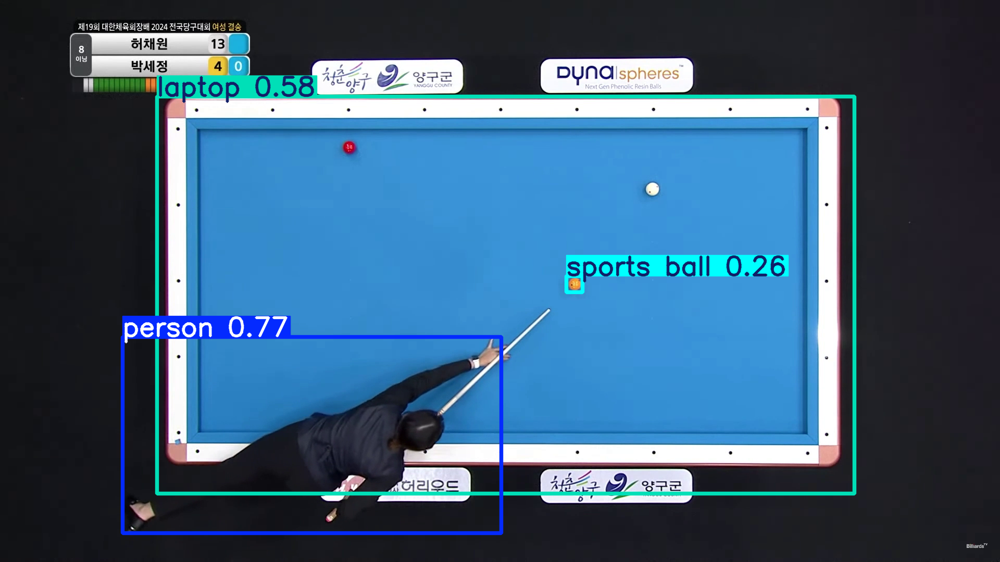


0: 384x640 1 person, 1 laptop, 651.3ms
Speed: 5.0ms preprocess, 651.3ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


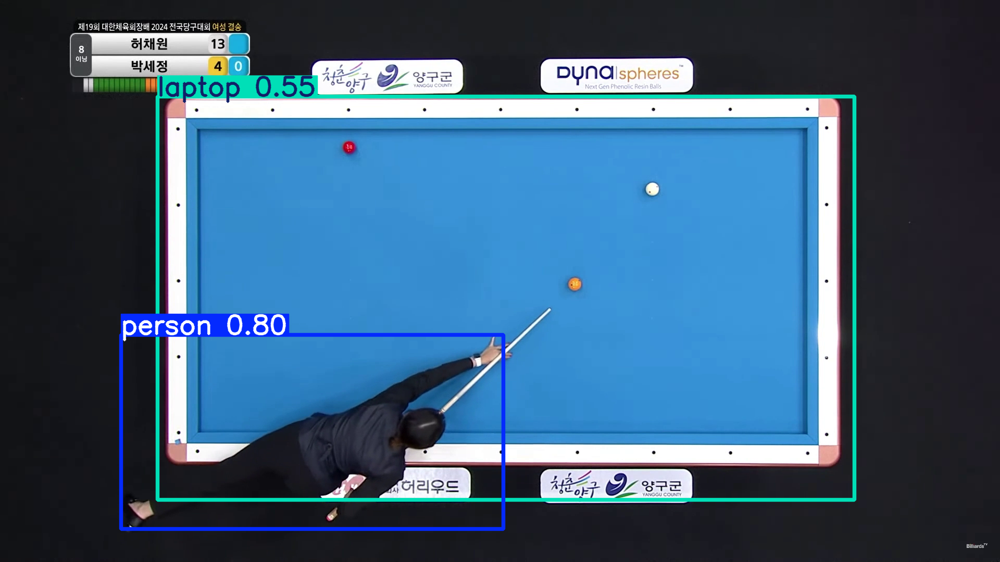


0: 384x640 1 person, 1 laptop, 620.0ms
Speed: 4.0ms preprocess, 620.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


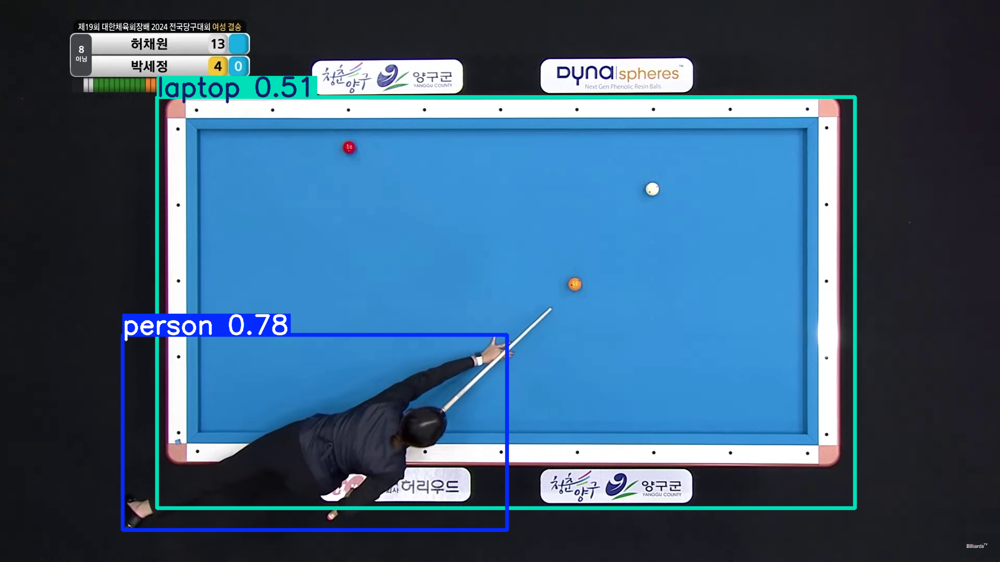


0: 384x640 1 person, 1 laptop, 648.0ms
Speed: 4.1ms preprocess, 648.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


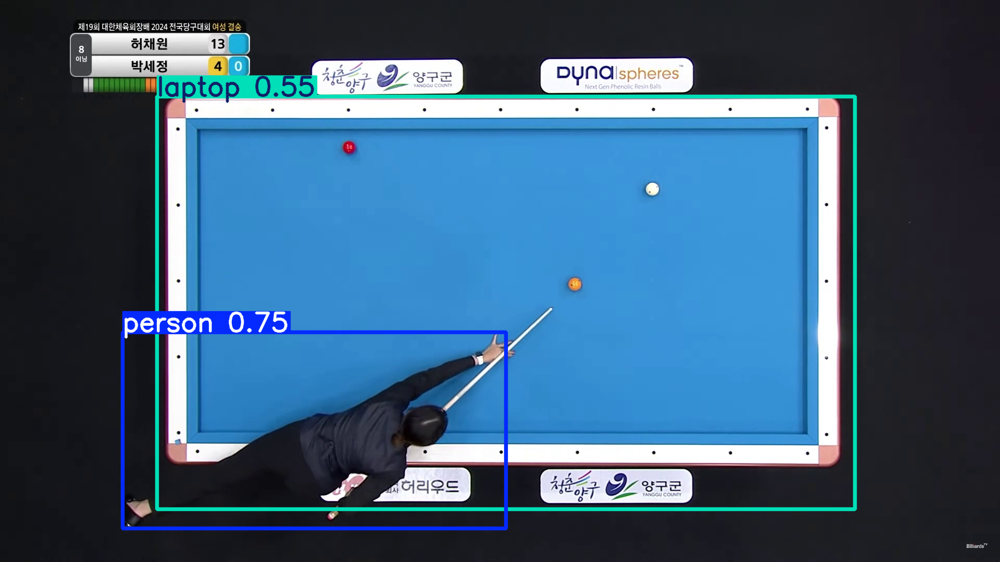


0: 384x640 1 person, 1 laptop, 593.9ms
Speed: 3.9ms preprocess, 593.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


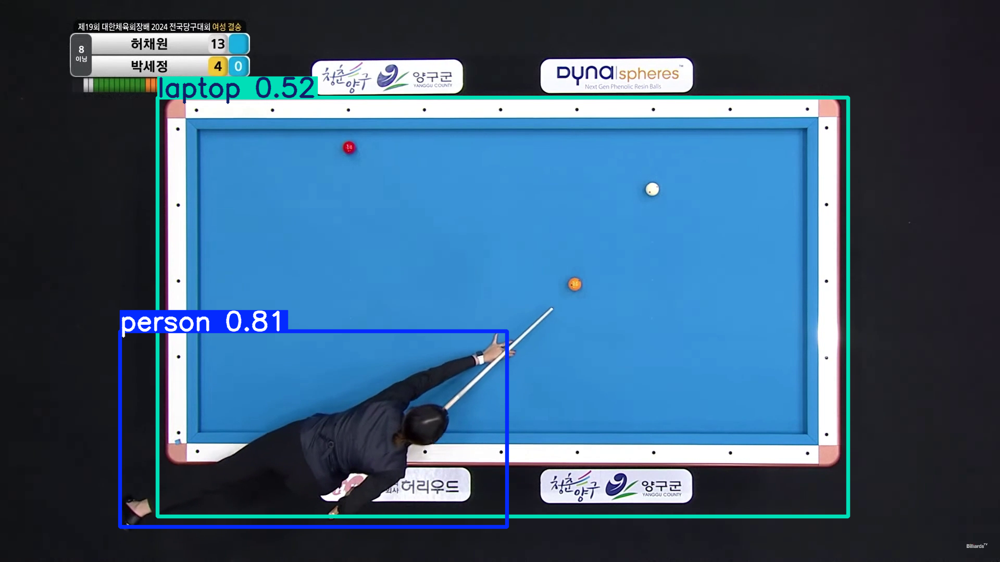


0: 384x640 1 person, 1 laptop, 625.9ms
Speed: 6.3ms preprocess, 625.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


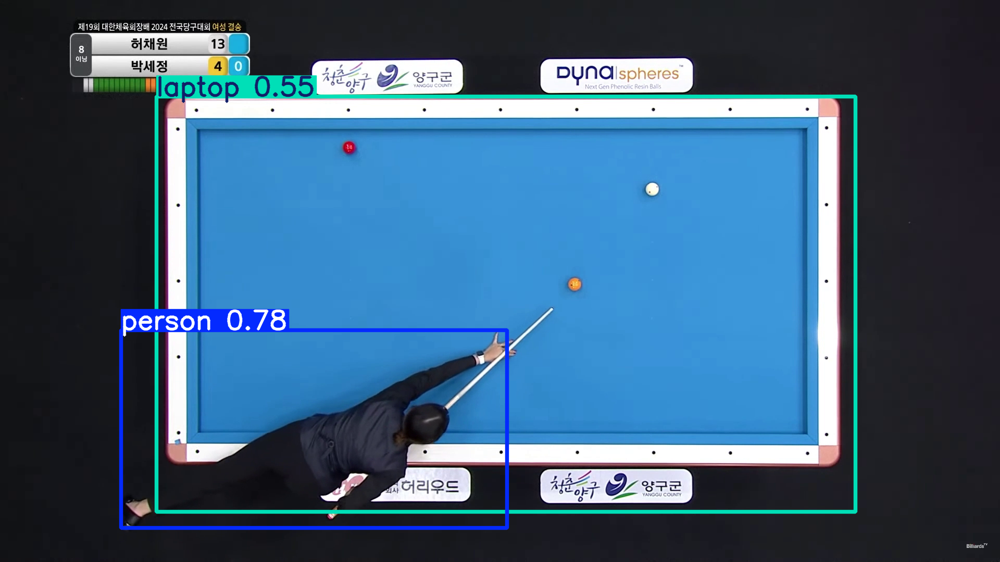


0: 384x640 1 person, 1 laptop, 719.1ms
Speed: 3.9ms preprocess, 719.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


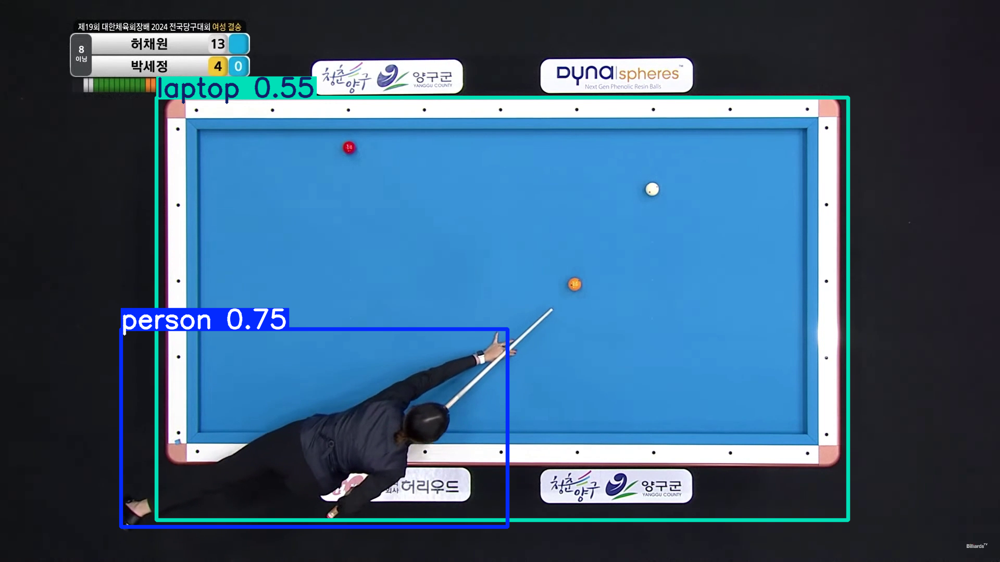


0: 384x640 1 person, 1 laptop, 637.8ms
Speed: 7.1ms preprocess, 637.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


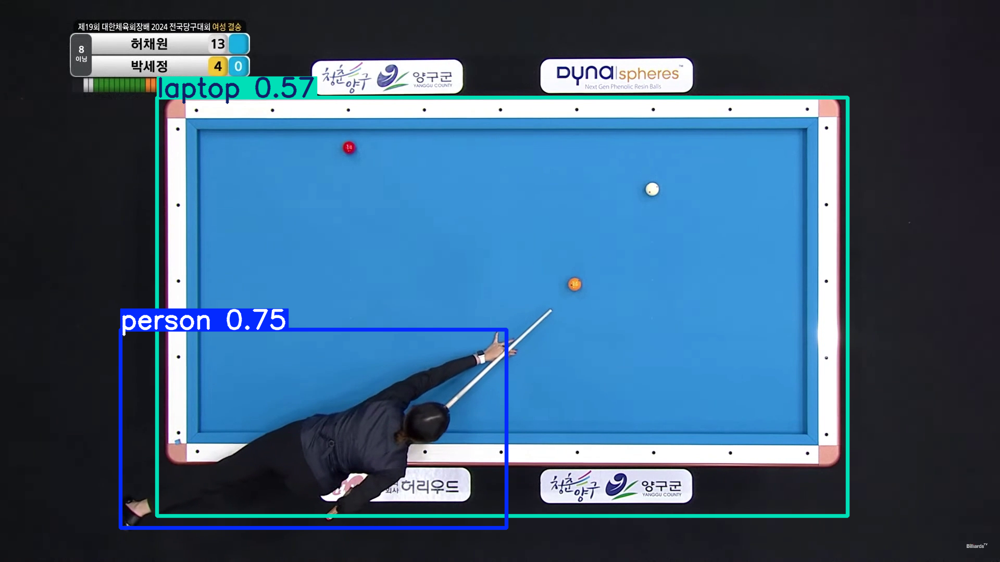


0: 384x640 1 person, 1 laptop, 619.5ms
Speed: 6.7ms preprocess, 619.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


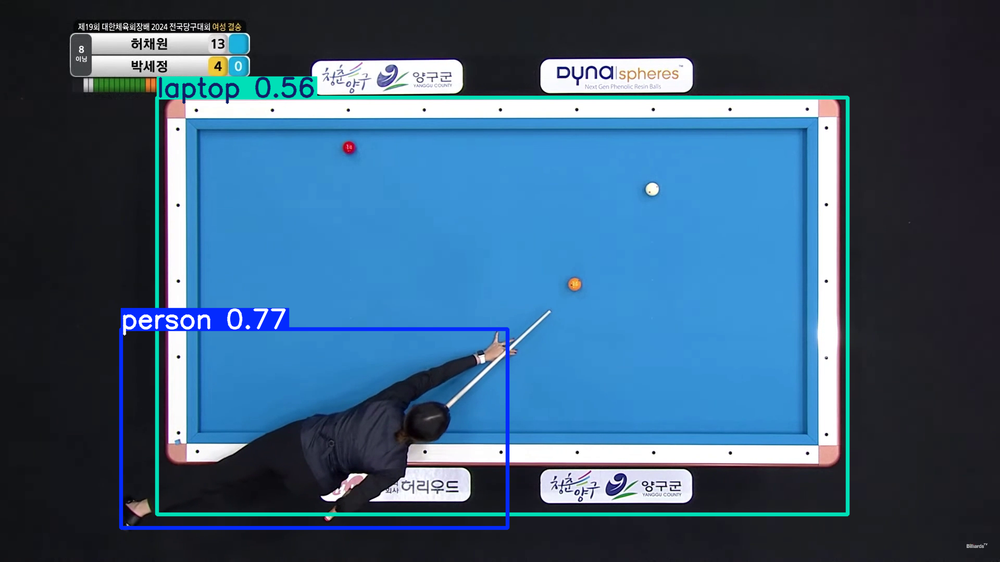


0: 384x640 1 person, 1 laptop, 637.4ms
Speed: 7.2ms preprocess, 637.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


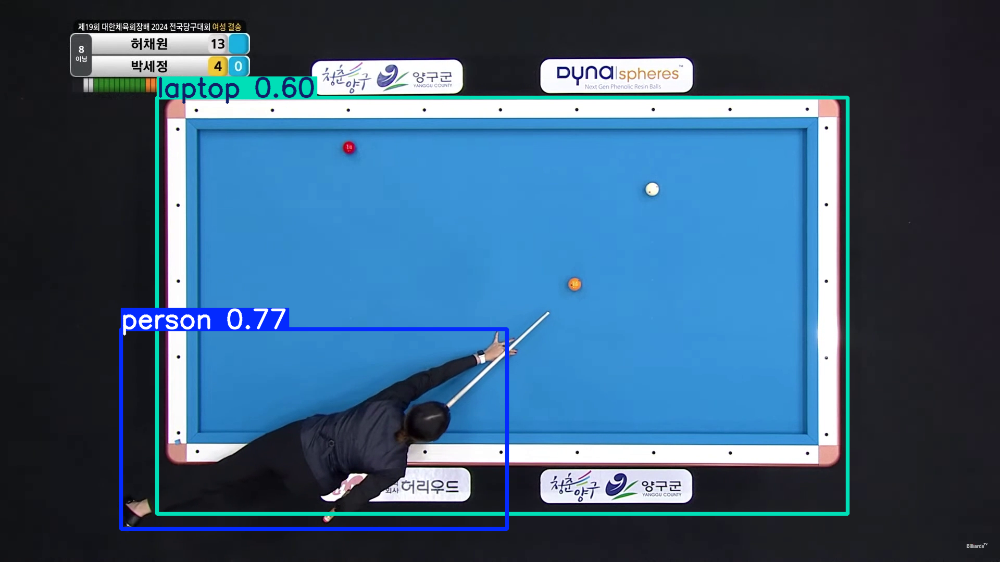


0: 384x640 1 person, 1 laptop, 675.8ms
Speed: 3.9ms preprocess, 675.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


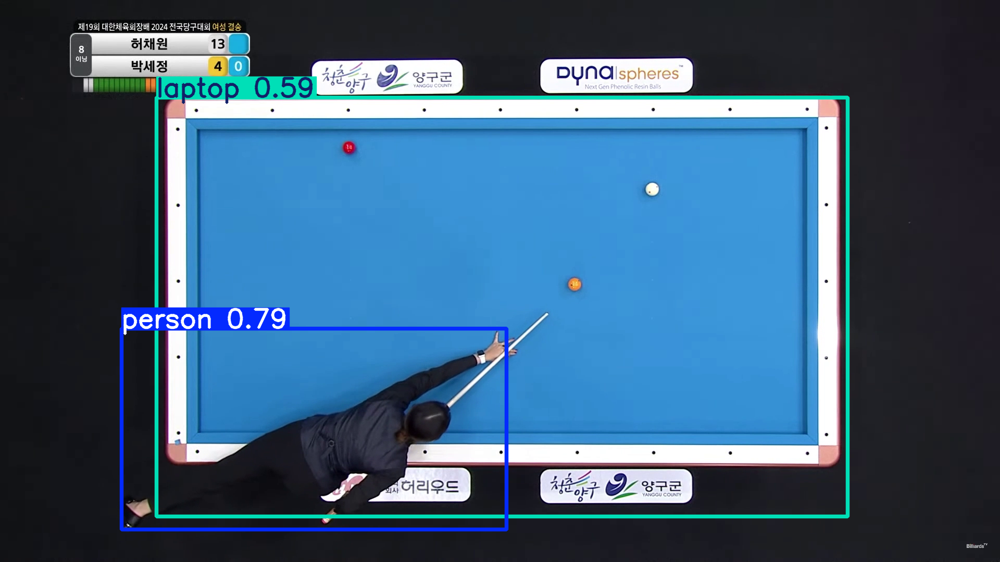


0: 384x640 1 person, 1 laptop, 685.3ms
Speed: 4.3ms preprocess, 685.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


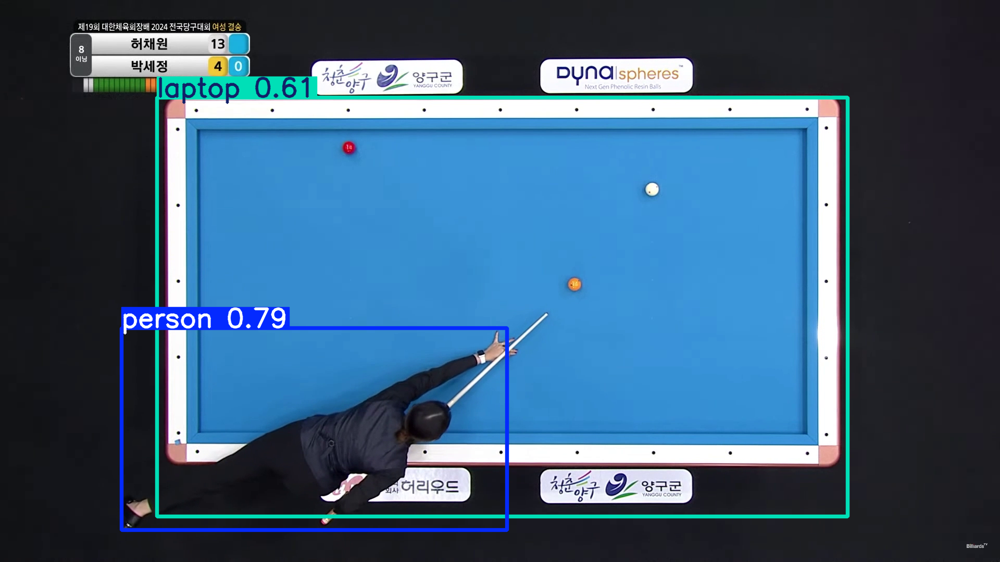


0: 384x640 1 person, 1 laptop, 688.6ms
Speed: 3.9ms preprocess, 688.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


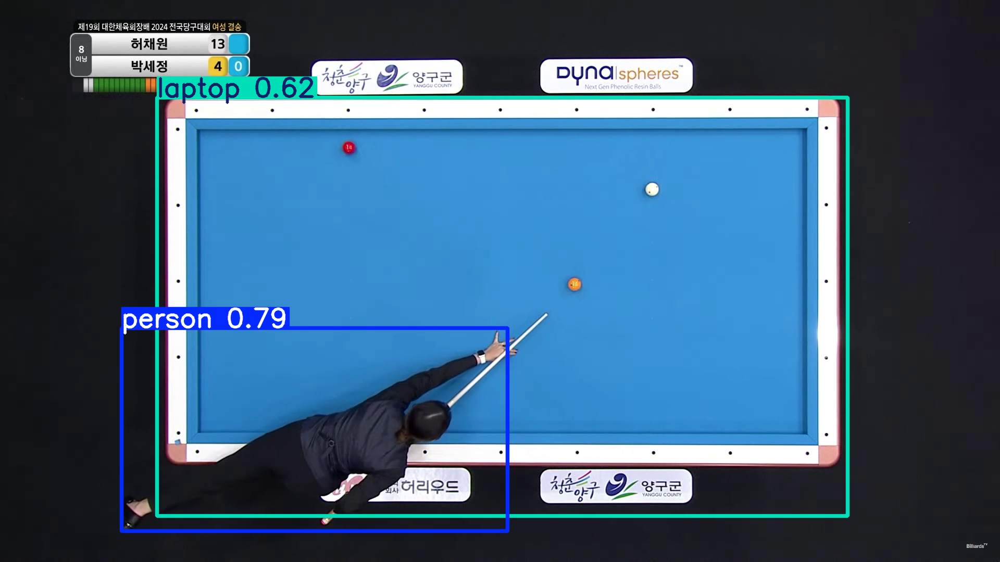


0: 384x640 1 person, 1 sports ball, 1 laptop, 695.2ms
Speed: 5.0ms preprocess, 695.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


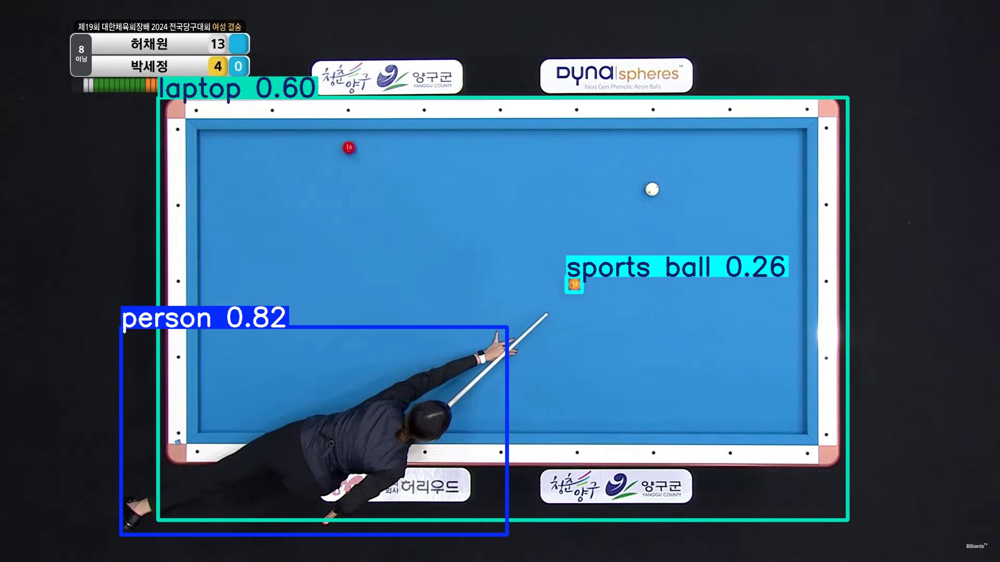


0: 384x640 1 person, 1 sports ball, 1 laptop, 603.1ms
Speed: 4.1ms preprocess, 603.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


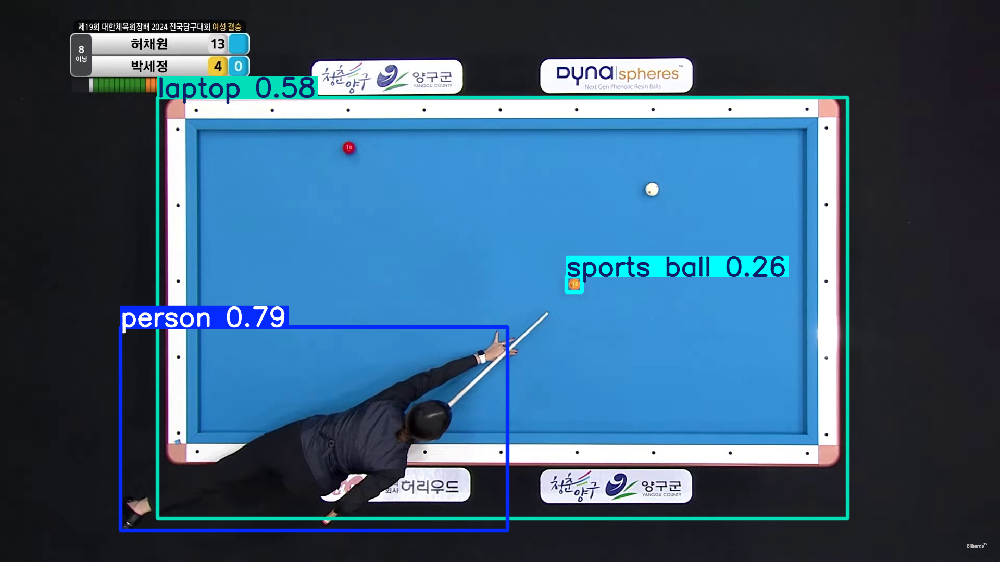


0: 384x640 1 person, 1 sports ball, 1 laptop, 617.4ms
Speed: 8.0ms preprocess, 617.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


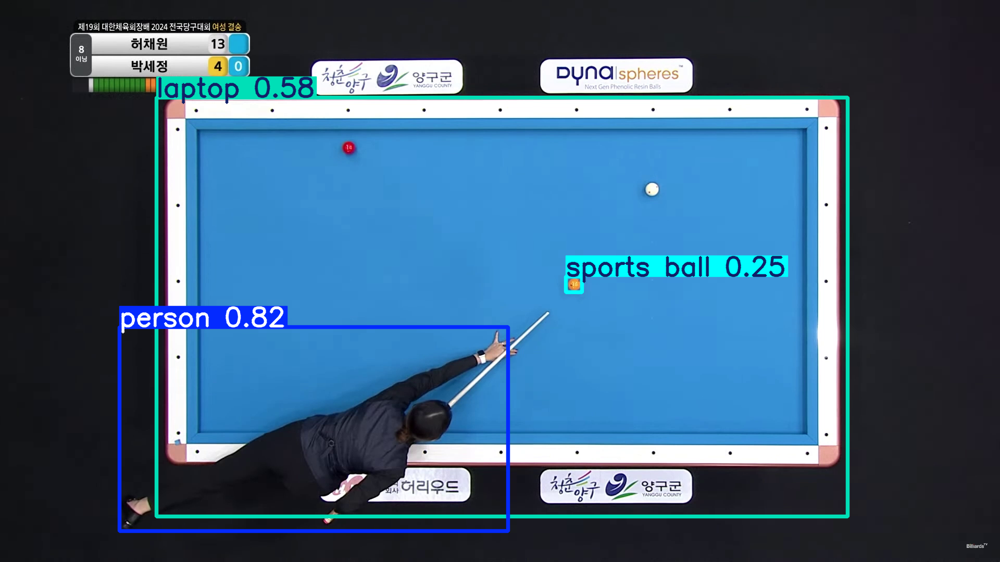

KeyboardInterrupt: 

In [ ]:
# 동영상을 바로 읽어서 분류하는 기능

from ultralytics import YOLO
import cv2


model = YOLO("yolov8s.pt")
cap = cv2.VideoCapture("/content/drive/MyDrive/billiard_game.mp4")

while cap.isOpened() :
    ret, frame = cap.read()

    if ret :
        results = model(frame)
        #cv2.imshow("Results", results[0].plot())
        cv2_imshow(results[0].plot())

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cv2.destroyAllWindows()
cap.release()

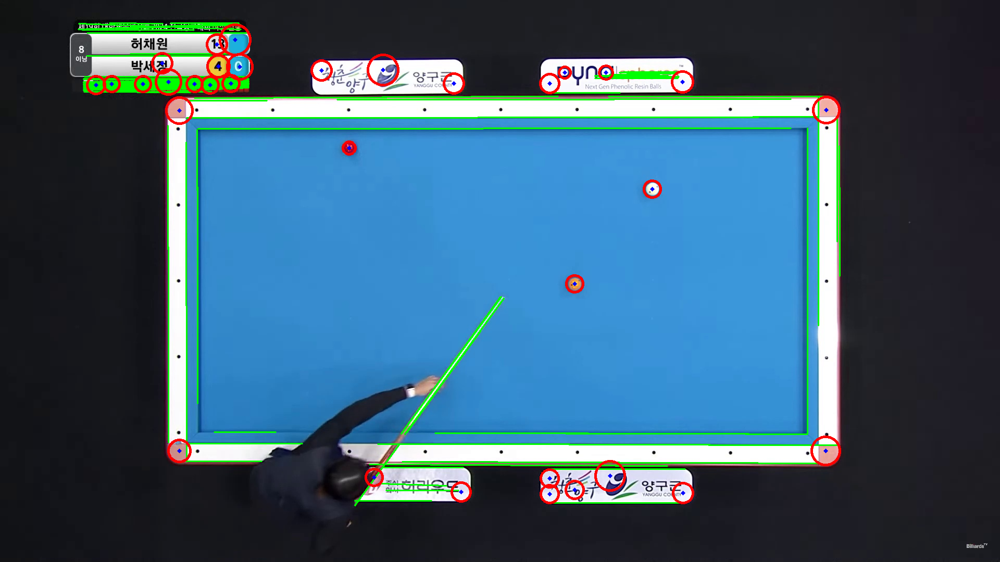

In [ ]:
#공을 추출, 당구대 추출하는 기능

import cv2
import numpy as np
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load the image
image = cv2.imread('/content/drive/MyDrive/Billiard/Input_mp4/frames/single_frame.jpg')
original = image.copy()
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
blurred = cv2.GaussianBlur(gray, (5, 5), 0)

# Step 1: Detect edges for table boundaries
edges = cv2.Canny(blurred, threshold1=50, threshold2=150)
lines = cv2.HoughLinesP(edges, rho=1, theta=np.pi/180, threshold=100, minLineLength=100, maxLineGap=10)

# Draw table boundaries
if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

# Step 2: Detect balls using Hough Circle Transform
circles = cv2.HoughCircles(blurred, cv2.HOUGH_GRADIENT, dp=1.2, minDist=30, param1=50, param2=30, minRadius=10, maxRadius=30)

# Draw detected balls
if circles is not None:
    circles = np.uint16(np.around(circles))
    for circle in circles[0, :]:
        x, y, r = circle
        cv2.circle(image, (x, y), r, (0, 0, 255), 3)
        cv2.circle(image, (x, y), 2, (255, 0, 0), 3)  # Ball center

# Display results
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()


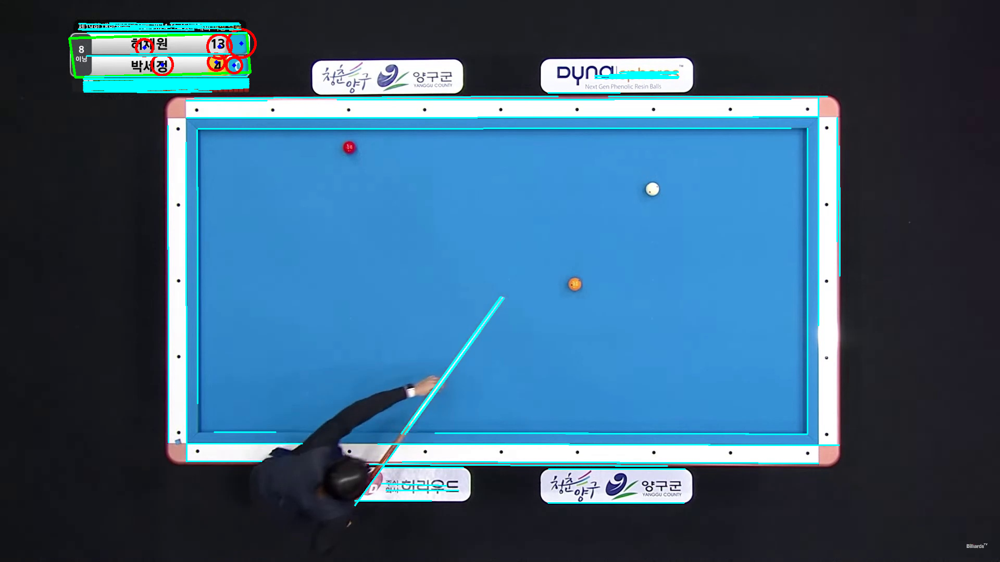

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load the image
image = cv2.imread('/content/drive/MyDrive/Billiard/Input_mp4/frames/single_frame.jpg')
original = image.copy()
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
blurred = cv2.GaussianBlur(gray, (5, 5), 0)

# Step 1: Detect table (largest rectangle)
edges = cv2.Canny(blurred, threshold1=50, threshold2=150)
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Find the largest rectangle
table_contour = None
max_area = 0
for contour in contours:
    approx = cv2.approxPolyDP(contour, 0.02 * cv2.arcLength(contour, True), True)
    if len(approx) == 4:  # Rectangle has 4 sides
        area = cv2.contourArea(contour)
        if area > max_area:
            max_area = area
            table_contour = approx

# Draw the table
if table_contour is not None:
    cv2.drawContours(image, [table_contour], -1, (0, 255, 0), 3)

# Step 2: Mask the table region
table_mask = np.zeros_like(gray)
if table_contour is not None:
    cv2.fillPoly(table_mask, [table_contour], 255)

# Step 3: Detect balls inside the table
masked_gray = cv2.bitwise_and(gray, gray, mask=table_mask)
circles = cv2.HoughCircles(masked_gray, cv2.HOUGH_GRADIENT, dp=1.2, minDist=20, param1=50, param2=30, minRadius=10, maxRadius=30)

# Draw detected balls
if circles is not None:
    circles = np.uint16(np.around(circles))
    for circle in circles[0, :]:
        x, y, r = circle
        cv2.circle(image, (x, y), r, (0, 0, 255), 3)
        cv2.circle(image, (x, y), 2, (255, 0, 0), 3)  # Ball center

# Step 4: Detect cue stick (long straight lines)
lines = cv2.HoughLinesP(edges, rho=1, theta=np.pi/180, threshold=100, minLineLength=100, maxLineGap=10)
if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(image, (x1, y1), (x2, y2), (255, 255, 0), 2)

# Display results
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()


In [ ]:
!pip install ultralytics


0: 384x640 1 person, 1 laptop, 635.7ms
Speed: 12.7ms preprocess, 635.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


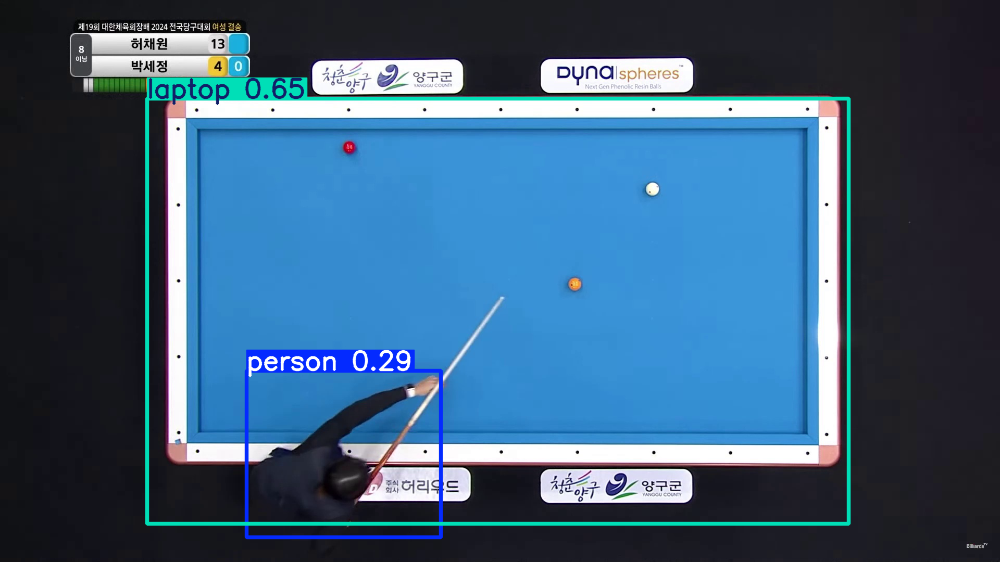

KeyboardInterrupt: 

In [ ]:
from ultralytics import YOLO
import cv2


model = YOLO("yolov8s.pt")
cap = cv2.VideoCapture("/content/drive/MyDrive/Billiard/Input_mp4/frames/single_frame.jpg")

while cap.isOpened() :
    ret, frame = cap.read()

    if ret :
        results = model(frame)
        #cv2.imshow("Results", results[0].plot())
        cv2_imshow(results[0].plot())

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cv2.destroyAllWindows()
cap.release()

In [ ]:
!pip install ultralytics
!pip install opencv-python-headless


0: 384x640 1 tv, 148.8ms
Speed: 4.6ms preprocess, 148.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


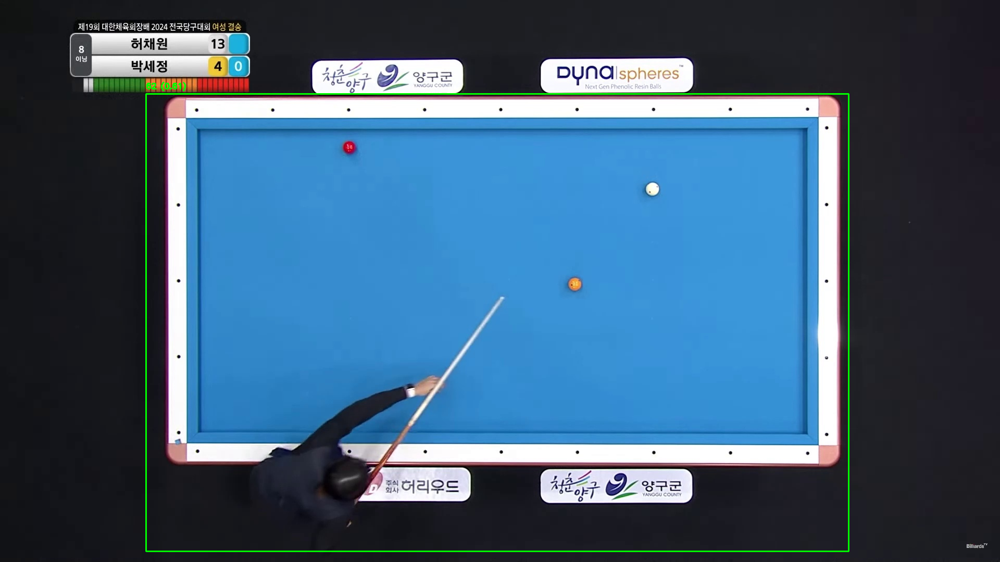

In [ ]:
#------------------------------------------------
# 사진을 읽어서 해당 클래스, 신뢰도점수 표시
#------------------------------------------------

import cv2
import numpy as np
from ultralytics import YOLO  # YOLO library for object detection
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load YOLOv8 model pre-trained on COCO dataset
model = YOLO('yolov8n.pt')  # COCO includes 'tv' and 'sports ball' classes

# Load the image
image = cv2.imread('/content/drive/MyDrive/Billiard/Input_mp4/frames/single_frame.jpg')

# Run the model on the image
results = model(image)

# Get detections for 'tv' and 'sports ball' only
#detections = results.xyxy[0].numpy()  # Extract bounding box predictions

for detection in results[0].boxes:
    class_id = int(detection.cls)  # Class ID
    conf = float(detection.conf)  # Confidence score
    x1, y1, x2, y2 = detection.xyxy[0].cpu().numpy()

    if class_id in [62, 32]:  # Filter for 'tv' and 'sports ball'
        # Draw the bounding box
        cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
        # Add label
        label = f"{class_id} ({conf:.2f})"
        cv2.putText(image, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display the results
cv2_imshow(image)

cv2.waitKey(0)
cv2.destroyAllWindows()


In [ ]:
import cv2
import numpy as np
from ultralytics import YOLO  # YOLO library for object detection
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load YOLOv8 model pre-trained on COCO dataset
model = YOLO('yolov8n.pt')  # COCO includes 'tv' and 'sports ball' classes

# Load the image
image = cv2.imread('/content/drive/MyDrive/Billiard/Input_mp4/frames/single_frame.jpg')

# Run the model on the image
results = model(image)

# Get detections for 'tv' and 'sports ball' only
detections = results.xyxy[0].numpy()  # Extract bounding box predictions
for detection in detections:
    x1, y1, x2, y2, conf, class_id = detection
    class_name = results.names[int(class_id)]
    if class_name in ['tv', 'sports ball']:  # Filter for 'tv' and 'sports ball'
        # Draw the bounding box
        cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
        # Add label
        label = f"{class_name} ({conf:.2f})"
        cv2.putText(image, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display the results
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()
# Access the class names
class_names = model.names

# Print class names
for class_id, class_name in class_names.items():
    print(f"Class ID: {class_id}, Class Name: {class_name}")


0: 384x640 1 tv, 230.4ms
Speed: 5.0ms preprocess, 230.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


AttributeError: 'list' object has no attribute 'xyxy'

In [ ]:
#--------------------------------------------
# 올로모델이 가지고 있는 calss의 종류확인
#--------------------------------------------

from ultralytics import YOLO  # YOLO library for object detection

# Load YOLOv8 model pre-trained on COCO dataset
model = YOLO('yolov8n.pt')  # COCO includes 'tv' and 'sports ball' classes

# Access the class names
class_names = model.names

# Print class names
for class_id, class_name in class_names.items():
    print(f"Class ID: {class_id}, Class Name: {class_name}")

Class ID: 0, Class Name: person
Class ID: 1, Class Name: bicycle
Class ID: 2, Class Name: car
Class ID: 3, Class Name: motorcycle
Class ID: 4, Class Name: airplane
Class ID: 5, Class Name: bus
Class ID: 6, Class Name: train
Class ID: 7, Class Name: truck
Class ID: 8, Class Name: boat
Class ID: 9, Class Name: traffic light
Class ID: 10, Class Name: fire hydrant
Class ID: 11, Class Name: stop sign
Class ID: 12, Class Name: parking meter
Class ID: 13, Class Name: bench
Class ID: 14, Class Name: bird
Class ID: 15, Class Name: cat
Class ID: 16, Class Name: dog
Class ID: 17, Class Name: horse
Class ID: 18, Class Name: sheep
Class ID: 19, Class Name: cow
Class ID: 20, Class Name: elephant
Class ID: 21, Class Name: bear
Class ID: 22, Class Name: zebra
Class ID: 23, Class Name: giraffe
Class ID: 24, Class Name: backpack
Class ID: 25, Class Name: umbrella
Class ID: 26, Class Name: handbag
Class ID: 27, Class Name: tie
Class ID: 28, Class Name: suitcase
Class ID: 29, Class Name: frisbee
Class ID:


0: 384x640 1 person, 1 laptop, 619.7ms
Speed: 4.3ms preprocess, 619.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


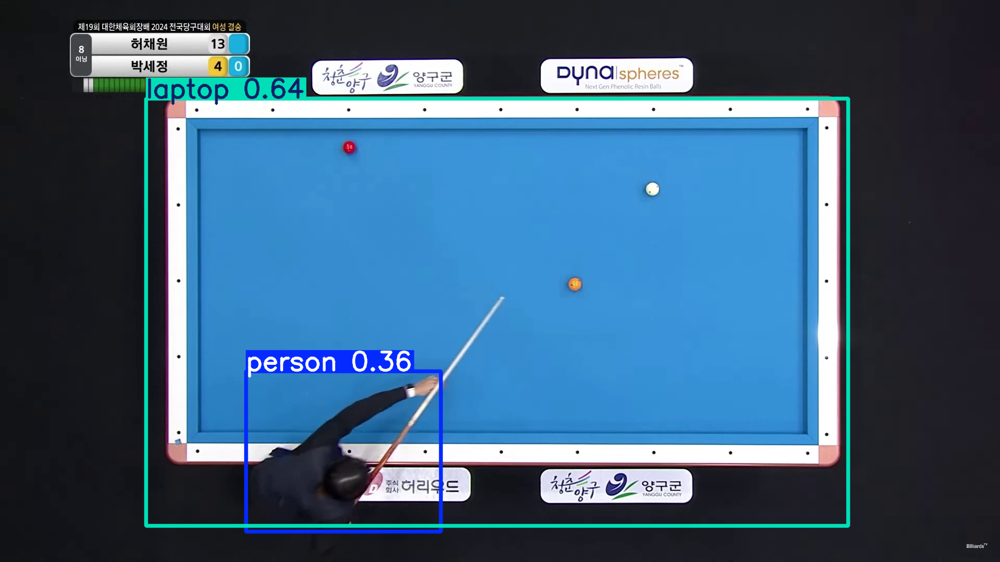

2
class_id:63
class_id:0


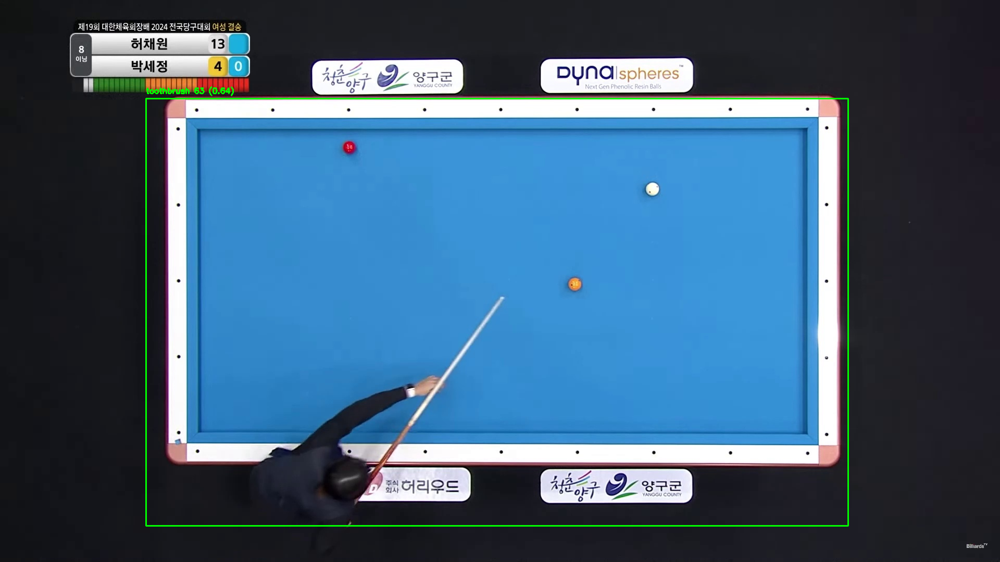

' \n - 오브젝트 분류한다.\n - 그중 분류한 class중 당구대(tv 혹은 laptop) 인경우\n   다시 그 대상 안의 공을 추출한다\n - 추출된 당구대, 공의 위치중 사용자의 공이 어떤것인지 체크\n - 사용자의 공으로 경로를 예측한다.\n - 학습자료는 실시간 동영상으로  \n\n - class에 당구대와 공(3개 각각의 공)을 등록한다.\n\n'

In [ ]:

import cv2
import numpy as np
from ultralytics import YOLO  # YOLO library for object detection
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab


"""
62: 'tv'
63: 'laptop'
32: 'sports ball'
0: 'person'
"""

# Load YOLOv8 model pre-trained on COCO dataset
#model = YOLO('yolov8n.pt')  # COCO includes 'tv' and 'sports ball' classes
model = YOLO('yolov8s.pt')

# Load the image
image = cv2.imread('/content/drive/MyDrive/Billiard/Input_mp4/frames/single_frame.jpg')
original = image.copy()
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
blurred = cv2.GaussianBlur(gray, (5, 5), 0)


# 이미지를 넣어 모델 실행
results = model(image)
cv2_imshow(results[0].plot())


#현재 이미지가 가지고 있는 class를 먼저 찾기
print(len(results[0].boxes.cls))

for detection in results[0].boxes:
    class_id = int(detection.cls)  # Class ID
    conf = float(detection.conf)  # Confidence score
    x1, y1, x2, y2 = detection.xyxy[0].cpu().numpy()

    print(f'class_id:{class_id}')

    #찾아진 class_id 종류에서 tv, laptop만추린다.
    if class_id == 63:  # 'laptop'인경우
        # Draw the bounding box
        cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
        label = f"{class_name} {class_id} ({conf:.2f})"
        cv2.putText(image, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    elif class_id == 62:   # 'tv'인경우
        cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
        label = f"{class_name} {class_id} ({conf:.2f})"
        cv2.putText(image, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    elif class_id == 32:   # sports ball 인경우
        # Step 2: Hough Circle Transform을 사용하여 공 감지
        circles = cv2.HoughCircles(blurred, cv2.HOUGH_GRADIENT, dp=1.2, minDist=30, param1=50, param2=30, minRadius=10, maxRadius=30)

        # 감지된 공 그리기
        if circles is not None:
            circles = np.uint16(np.around(circles))
            for circle in circles[0, :]:
                x, y, r = circle
                cv2.circle(image, (x, y), r, (0, 0, 255), 3)
                cv2.circle(image, (x, y), 2, (255, 0, 0), 3)  # Ball center

cv2_imshow(image)




"""
# Step 1: 테이블 경계의 가장자리 감지
edges = cv2.Canny(blurred, threshold1=50, threshold2=150)
lines = cv2.HoughLinesP(edges, rho=1, theta=np.pi/180, threshold=100, minLineLength=100, maxLineGap=10)

# 테이블 경계 그리기
if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

# Step 2: Hough Circle Transform을 사용하여 공 감지
circles = cv2.HoughCircles(blurred, cv2.HOUGH_GRADIENT, dp=1.2, minDist=30, param1=50, param2=30, minRadius=10, maxRadius=30)

# 감지된 공 그리기
if circles is not None:
    circles = np.uint16(np.around(circles))
    for circle in circles[0, :]:
        x, y, r = circle
        cv2.circle(image, (x, y), r, (0, 0, 255), 3)
        cv2.circle(image, (x, y), 2, (255, 0, 0), 3)  # Ball center




# Display the results
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()
"""


"""
 - 오브젝트 분류한다.
 - 그중 분류한 class중 당구대(tv 혹은 laptop) 인경우
   다시 그 대상 안의 공을 추출한다
 - 추출된 당구대, 공의 위치중 사용자의 공이 어떤것인지 체크
 - 사용자의 공으로 경로를 예측한다.
 - 학습자료는 실시간 동영상으로

 - class에 당구대와 공(3개 각각의 공)을 등록한다.

"""
